In [1]:
#####################################################################################################
#                                  Author: Anass MAJJI                                              #
#                               File Name: e_commerce_classification                                #
#                           Creation Date: June 13, 2024                                            #
#                         Source Language: Python                                                   #
#         Repository:    https://github.com/amajji/e_commerce-classification-products               #
#                              --- Code Description ---                                             #
#                  Script to predict each product's category in a e_commerce plateform                                                           #
#####################################################################################################


# Import packages

In [3]:
# Import libraries:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
from sklearn import metrics
from sklearn.model_selection import GridSearchCV
import matplotlib.pylab as plt
from matplotlib.pylab import rcParams
from matplotlib.ticker import StrMethodFormatter
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelEncoder

/home/majji/anaconda3/lib/python3.7/site-packages/dask/dataframe/utils.py:13: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Functions

In [4]:
def cm_analysis(y_true, y_pred, labels, ymap=None, figsize=(10, 10)):
    """
    Generate matrix plot of confusion matrix with pretty annotations.
    The plot image is saved to disk.
    args:
      y_true:    true label of the data, with shape (nsamples,)
      y_pred:    prediction of the data, with shape (nsamples,)
      filename:  filename of figure file to save
      labels:    string array, name the order of class labels in the
                  confusion matrix.
                 use `clf.classes_` if using scikit-learn models.
                 with shape (nclass,).
      ymap:      dict: any -> string, length == nclass.
                 if not None, map the labels & ys to more understandable
                 strings.
                 Caution: original y_true, y_pred and labels must align.
      figsize:   the size of the figure plotted.
    """

    if ymap is not None:
        # change category codes or labels to new labels
        y_pred = [ymap[yi] for yi in y_pred]
        y_true = [ymap[yi] for yi in y_true]
        labels = [ymap[yi] for yi in labels]
    # calculate a confusion matrix with the new labels
    cm = confusion_matrix(y_true, y_pred, labels=labels)
    # calculate row sums (for calculating % & plot annotations)
    cm_sum = np.sum(cm, axis=1, keepdims=True)
    # calculate proportions
    cm_perc = cm / cm_sum.astype(float) * 100
    # empty array for holding annotations for each cell in the heatmap
    annot = np.empty_like(cm).astype(str)
    # get the dimensions
    nrows, ncols = cm.shape

    # cycle over cells and create annotations for each cell
    for i in range(nrows):
        for j in range(ncols):
            # get the count for the cell
            c = cm[i, j]
            # get the percentage for the cell
            p = cm_perc[i, j]
            if i == j:
                s = cm_sum[i]
                # convert the proportion, count, and row
                # sum to a string with pretty formatting
                annot[i, j] = "%.1f%%\n%d/%d" % (p, c, s)
            elif c == 0:
                annot[i, j] = ""
            else:
                annot[i, j] = "%.1f%%\n%d" % (p, c)
    # convert the array to a dataframe. To plot by proportion
    # instead of number, use cm_perc in the DataFrame instead of cm
    cm = pd.DataFrame(cm, index=labels, columns=labels)
    cm.index.name = "Actual"
    cm.columns.name = "Predicted"

    # create empty figure with a specified size
    fig, ax = plt.subplots(figsize=figsize)

    # plot the data using the Pandas dataframe. To change
    # the color map, add cmap=..., e.g. cmap = 'rocket_r'
    sns.heatmap(cm, annot=annot, fmt="", ax=ax)
    # plt.savefig(filename)
    plt.show()

# Read datasets

- Train dataset

In [5]:
# read train dataset
df_train = pd.read_csv("data_train.csv.gz")

print("Train dataset's number of rows : ", df_train.shape[0])

Train dataset's number of rows :  241483


- Test dataset

In [6]:
# read test dataset
df_test = pd.read_csv("data_test.csv.gz")

print("Test dataset's number of rows : ", df_test.shape[0])

Test dataset's number of rows :  44738


- Parent of each category

In [7]:
# get Parent of each category
df_category_parent = pd.read_csv("category_parent.csv")

# Data Preprocessing, Analysis, and Visualization

- I this part, we are going to concatenate train and test datasets and add parent's category for each target

In [8]:
# add train label for train dataset
df_train["dataset"] = "train"

# add test label for test dataset
df_test["dataset"] = "test"

# concatenate train and test datasets
df_finale = pd.concat([df_train, df_test], axis=0)

# Add the parent for each category
df_finale = pd.merge(df_finale, df_category_parent, on="category_id", how="left")

min_value, max_value = df_finale["category_id"].min(), df_finale["category_id"].max()

- Drop product_id

In [9]:
# count the unique values of product_id
print(
    "The percentage of the unique product_id in the "
    + f"entire   dataset : {100*df_finale['product_id'].nunique()/df_finale.shape[0]}%"
)

The percentage of the unique product_id in the entire   dataset : 100.0%


This shows that the product_id is an unique identifier. We won't use it as a feature during training. 


- parent_id

In the next cell, we check that each category has only one parent. 

In [10]:
print(
    "Is each category's ID has only one parent ? ",
    sorted(
        df_category_parent.groupby("category_id")
        .nunique("parent_id")["parent_id"]
        .unique()
        .tolist()
    )
    == [0, 1],
)

Is each category's ID has only one parent ?  True


## Duplicated rows

In this section, we are going to group duplicated rows based on their features without targets. Then we perform a deep analysis on it. For that, we attribute an unique identifier for each duplicated rows.

In [11]:
# Attribute a number for each duplicated rows' bloc
df_finale["num_duplicated_rows"] = df_finale.groupby(
    [
        col
        for col in df_finale.columns
        if col not in ["category_id", "product_id", "parent_id", "dataset"]
    ]
).ngroup()

# convert target's dtype into string
df_finale["category_id"] = df_finale["category_id"].astype(str)

# get duplicated rows in train and test datasets
df_finale_duplicated_rows = df_finale.loc[
    (
        df_finale[
            [
                col
                for col in df_finale.columns
                if col
                not in [
                    "category_id",
                    "product_id",
                    "parent_id",
                    "dataset",
                    "num_duplicated_rows",
                ]
            ]
        ].duplicated()
    )
]


print(
    f"Number of duplicated rows is {df_finale_duplicated_rows.shape[0]}"
    + f" which corresponds to :  {df_finale_duplicated_rows.shape[0]/df_finale.shape[0]:.0%}"
)

Number of duplicated rows is 3956 which corresponds to :  1%


In [12]:
# get the number of unique target values per duplicated bloc
duplicated_rows_gby = (
    df_finale_duplicated_rows.groupby(["num_duplicated_rows", "dataset"])
    .agg({"product_id": "unique", "category_id": "unique", "parent_id": "unique"})
    .rename(
        columns={
            "product_id": "list_product_id",
            "category_id": "unique_category_id",
            "parent_id": "unique_parent_id",
        }
    )
    .reset_index()
)

# compute nunique products' ids
duplicated_rows_gby["count_product_id"] = duplicated_rows_gby["list_product_id"].apply(
    lambda x: len(x)
)

# rename the number of category's : "One unique category" when count_category_id == 1 and Two unique categories
# when it's equal to 2
duplicated_rows_gby["count_unique_category"] = duplicated_rows_gby[
    "unique_category_id"
].apply(lambda x: "One unique category" if len(x) == 1 else "Two unique categories")

# rename the number of parent's : "One unique parent" when unique_parent_id == 1 and Two unique parents
# when it's equal to 2
duplicated_rows_gby["count_unique_parent"] = duplicated_rows_gby[
    "unique_parent_id"
].apply(lambda x: "One unique parent" if len(x) == 1 else "Two unique parents")

# figure to plot the number of products per class
fig = go.Figure(
    data=[
        go.Pie(
            labels=duplicated_rows_gby["count_unique_category"],
            values=duplicated_rows_gby["count_product_id"],
            textinfo="label+percent",
            insidetextorientation="radial",
            title="Distribution of different categories of duplicated rows",
        )
    ]
)
# show figure
fig.show()

In [13]:
duplicated_rows_gby.groupby("count_unique_category").agg(
    {"count_unique_parent": "unique"}
)

,count_unique_parent
count_unique_category,
One unique category,[One unique parent]
Two unique categories,"[Two unique parents, One unique parent]"


As we can see from the above figure and tab, duplicated rows (same features) with one unique category represent 54% of the total number of duplicated rows in the entire database and have only one parent each, whereas duplicated rows with two unique categories represent 43% and could have one or two parents.

In [14]:
# figure to plot the number of different parents for rows with two different categories
fig = go.Figure(
    data=[
        go.Pie(
            labels=duplicated_rows_gby["count_unique_parent"],
            values=duplicated_rows_gby["count_product_id"],
            textinfo="label+percent",
            insidetextorientation="radial",
            title="Number of parents for duplicated rows with two categories",
        )
    ]
)
# show figure
fig.show()

Same conclusion here, 61% of the total number of duplicated rows with two categories have one parent and 39% have two parents. This could be explained by the fact that many products with the same caracteristics could be used in different categories with or without the same parent.

### Compare train and test databases

- In this part, we are going to perform a comparaison between train and test datasets: compare the distribution of each feature in train and test and check as well the distribution of the labels.

- Compare duplicated rows of train and test datasets

In [15]:
# duplicated rows of train dataset
duplicated_rows_train = df_finale_duplicated_rows[
    df_finale_duplicated_rows["dataset"] == "train"
]

# duplicated rows of test dataset
duplicated_rows_test = df_finale_duplicated_rows[
    df_finale_duplicated_rows["dataset"] == "test"
]

In [16]:
print(
    "The number of common duplicated rows in train & test datasets is : ",
    len(
        set(duplicated_rows_train["num_duplicated_rows"].unique()).intersection(
            duplicated_rows_test["num_duplicated_rows"].unique()
        )
    ),
)

The number of common duplicated rows in train & test datasets is :  0


- Check if we have duplicated product id in train and test and check their corresponding labels

In [17]:
intersection_id = list(
    set(
        df_finale.loc[(df_finale["dataset"] == "train")]["product_id"].unique()
    ).intersection(
        df_finale.loc[(df_finale["dataset"] == "test")]["product_id"].unique()
    )
)

print(
    f"Products in the intersection of train and test datasets : {len(intersection_id)}"
)

Products in the intersection of train and test datasets : 0


In [18]:
df_finale.describe()

,f0,f1,f2,f3,f4,f5,f6,f7,f8,f9,...,f120,f121,f122,f123,f124,f125,f126,f127,parent_id,num_duplicated_rows
count,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,...,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000,286221.000000
mean,-0.001164,0.000737,0.000128,-0.000289,-0.000546,-0.000269,-0.000537,0.000015,-0.000404,-0.000238,...,0.000010,-0.000077,-0.000043,-0.000084,-0.000007,-0.000054,-0.000062,-0.000061,6954.355938,141407.167776
std,0.106987,0.089783,0.071171,0.063460,0.055286,0.053085,0.048115,0.044999,0.041902,0.040736,...,0.011592,0.011586,0.011538,0.011404,0.011415,0.011288,0.011276,0.011174,4573.280477,81364.421181
min,-0.282818,-0.299667,-0.342901,-0.326951,-0.340842,-0.259085,-0.231023,-0.267998,-0.236863,-0.178814,...,-0.091347,-0.123063,-0.112994,-0.094811,-0.107742,-0.098399,-0.089273,-0.101608,65.000000,0.000000
25%,-0.081974,-0.064791,-0.051300,-0.043186,-0.028965,-0.038602,-0.030458,-0.028802,-0.026746,-0.024776,...,-0.006693,-0.006758,-0.006783,-0.006786,-0.006636,-0.006614,-0.006488,-0.006470,2958.000000,71230.000000
50%,-0.022189,-0.005968,-0.000302,-0.006118,-0.001974,-0.005306,-0.004173,-0.001979,0.001086,-0.000477,...,0.000087,0.000033,0.000089,-0.000140,0.000026,-0.000191,-0.000055,0.000036,5655.000000,141486.000000
75%,0.062846,0.054500,0.051455,0.035396,0.021233,0.034001,0.026373,0.026085,0.027328,0.023244,...,0.006749,0.006640,0.006755,0.006513,0.006668,0.006505,0.006447,0.006462,10147.000000,211809.000000
max,0.525338,0.495484,0.422739,0.390308,0.459381,0.262438,0.449142,0.275571,0.250631,0.377420,...,0.093514,0.123965,0.153605,0.102829,0.115144,0.098582,0.106333,0.122166,16147.000000,282264.000000


In [19]:
# One unique category / two unique categories in train and test within duplicated rows
fig = px.bar(
    duplicated_rows_gby.groupby(["dataset", "count_unique_category"])
    .sum()
    .reset_index(),
    x="dataset",
    y="count_product_id",
    color="count_unique_category",
)
fig.show()

In [20]:
# One unique parent / two unique parents in train and test within duplicated rows
fig = px.bar(
    duplicated_rows_gby.groupby(["dataset", "count_unique_parent"]).sum().reset_index(),
    x="dataset",
    y="count_product_id",
    color="count_unique_parent",
)
fig.show()

- Based on these results, we are going to process duplicated rows based on the following rules : 


    => For duplicated rows with the same class, we are going to keep only one row (in train and test)
    => Since we couldn't use the product's hierarchy as an input feature, for duplicated rows with two different classes with one or two parents, we are going to create a new class label which combine the two product's categories i.e for a product with category A & B, we create a new class 'A_B' 

#### Create a new label feature

As explained before, we create a new label feature which combines both labels for duplicated rows:

In [ ]:
# get the list of prouct_ids with two unique categories
new_labels_double_categories = duplicated_rows_gby.loc[
    (duplicated_rows_gby["count_unique_category"] == "Two unique categories")
][["list_product_id", "unique_category_id"]]

# join categories with "_" : classes "A" & "B" became "A_B"
new_labels_double_categories["new_label_2_categories"] = new_labels_double_categories[
    "unique_category_id"
].apply(lambda x: "_".join(list(x)))

# transpose the matrix to get in the end for each duplicated row its new label
new_labels_double_categories = (
    new_labels_double_categories.join(
        new_labels_double_categories.loc[
            new_labels_double_categories["list_product_id"].str.len() > 0,
            "list_product_id",
        ]
        .apply(pd.Series)
        .stack()
        .reset_index(1, name="product_id_rename")
    )
    .fillna("")
    .drop("level_1", 1)
    .reset_index(drop=True)
)[["product_id_rename", "new_label_2_categories"]].drop_duplicates()

dict_label_val = dict(
    zip(
        list(new_labels_double_categories["new_label_2_categories"].unique()),
        [
            max_value + 1000 * i
            for i in range(
                len(new_labels_double_categories["new_label_2_categories"].unique())
            )
        ],
    )
)


new_labels_double_categories[
    "new_label_2_categories_val"
] = new_labels_double_categories.apply(
    lambda x: dict_label_val[x["new_label_2_categories"]], axis=1
)
new_labels_double_categories

In [ ]:
# add new label to df_finale using a left join on product_id
df_finale = pd.merge(
    df_finale,
    new_labels_double_categories,
    left_on="product_id",
    right_on="product_id_rename",
    how="left",
)

# fill the empty value with ""
df_finale["new_label_2_categories"] = df_finale["new_label_2_categories"].fillna("")
df_finale["new_label_2_categories_val"] = df_finale[
    "new_label_2_categories_val"
].fillna("")

# create a 'new_label' feature that replaces the category of a product when it had two different categories
df_finale["new_label"] = df_finale.apply(
    lambda x: x["new_label_2_categories"]
    if x["new_label_2_categories"] != ""
    else x["category_id"],
    axis=1,
)

# create a 'new_label_val'
df_finale["new_label_val"] = df_finale.apply(
    lambda x: x["new_label_2_categories_val"]
    if x["new_label_2_categories_val"] != ""
    else x["category_id"],
    axis=1,
)

# drop "new_label_2_categories", "product_id_rename" columns
df_finale = df_finale.drop(
    [
        "new_label_2_categories",
        "new_label_2_categories_val",
        "product_id_rename",
        "new_label_2_categories_val",
    ],
    axis=1,
)

In [23]:
min_value, max_value

(77, 16149)

# Duplicated columns

- In this section, we check if we have a duplicated columns :

In [24]:
print(
    f"Number of duplicated columns is : {df_finale.shape[1] - df_finale.loc[:,~df_finale.apply(lambda x: x.duplicated(),axis=1).all()].shape[1]}"
)

Number of duplicated columns is : 0


### Target class distribution

In [25]:
# cout the number of product_id per class
df_count_target = df_finale["category_id"].value_counts(ascending=True)
df_count_target = 100 * df_count_target / df_finale.shape[0]

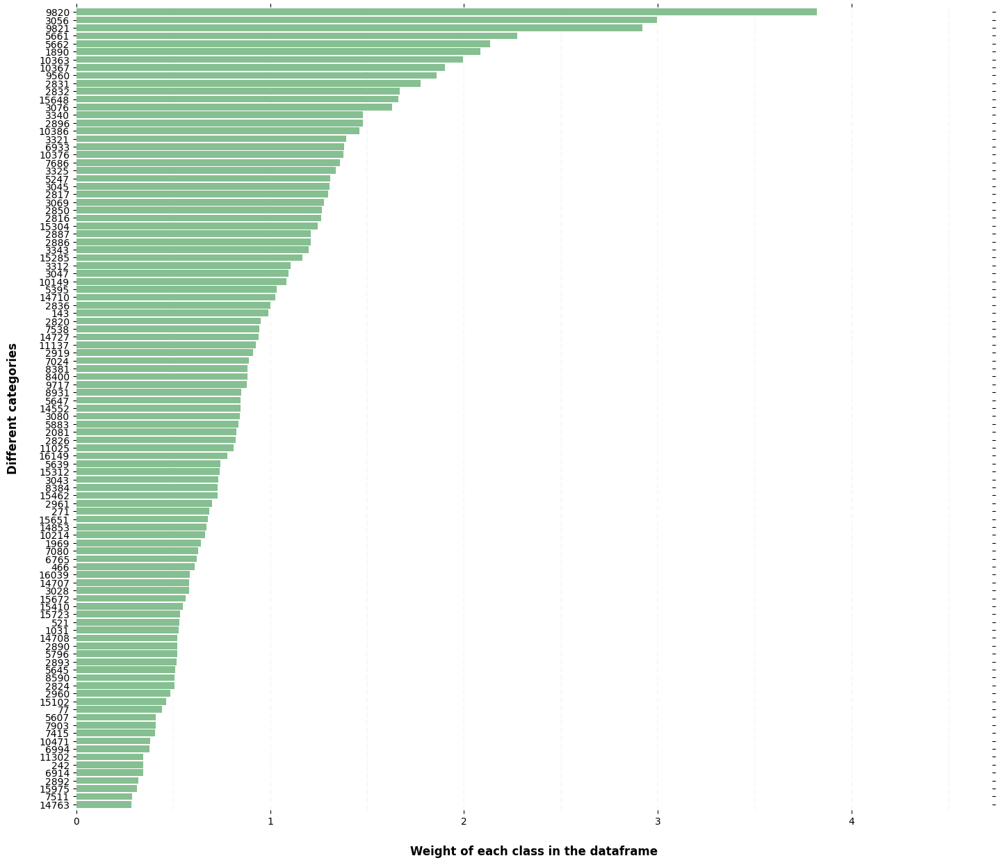

In [26]:
# plot the number of product_id per class
ax = df_count_target.plot(
    kind="barh", figsize=(17, 15), color="#86bf91", zorder=2, width=0.85
)

# Despine
ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)

# Switch off ticks
ax.tick_params(
    axis="both",
    which="both",
    bottom="off",
    top="off",
    labelbottom="on",
    left="off",
    right="off",
    labelleft="on",
)

# Draw vertical axis lines
vals = ax.get_xticks()
for tick in vals:
    ax.axvline(x=tick, linestyle="dashed", alpha=0.4, color="#eeeeee", zorder=1)

# Set x-axis label
ax.set_xlabel(
    "Weight of each class in the dataframe", labelpad=20, weight="bold", size=12
)

# Set y-axis label
ax.set_ylabel("Different categories", labelpad=20, weight="bold", size=12)

# Format y-axis label
ax.xaxis.set_major_formatter(StrMethodFormatter("{x:,g}"))

Based on the figure above, we have unbalanced classes. We should take that into consideration before training the model by either using an oversampling method like SMOTE technique or choosing a specific hyperparameter like the weight of each class during training.

# PCA

#### In this part, we are going to apply PCA to reduce dimensions.

In [ ]:
# list of id's and target 's column
col_ids = [
    "product_id",
    "category_id",
    "dataset",
    "parent_id",
    "num_duplicated_rows",
    "new_label",
    "new_label_val",
]

# split the dataframe into train and test
df_train = df_finale[df_finale["dataset"] == "train"]
df_test = df_finale[df_finale["dataset"] == "test"]

# get X_train, X_test & y_train, y_test from df_train and df_test
X_train, y_train_classif, y_train_regress = (
    df_train[[col for col in df_train.columns if col not in col_ids]],
    df_train["new_label"],
    df_train["new_label_val"].astype(int),
)

X_test, y_test_classif, y_test_regress = (
    df_test[[col for col in df_test.columns if col not in col_ids]],
    df_test["new_label"],
    df_test["new_label_val"].astype(int),
)

# category_id

In [28]:
X_train

,f0,f1,f2,f3,f4,f5,f6,f7,f8,f9,...,f118,f119,f120,f121,f122,f123,f124,f125,f126,f127
0,-0.006559,-0.120659,-0.004383,0.007749,-0.037135,-0.039693,-0.000479,-0.009981,-0.035670,-0.023168,...,0.012074,-0.002464,-0.005398,0.002239,-0.010406,-0.008286,0.007256,0.003646,0.007139,-0.011185
1,0.101763,-0.018803,-0.027987,-0.043492,0.096025,0.016519,0.010036,-0.015817,-0.021493,-0.001037,...,-0.001446,-0.002490,-0.006619,-0.018201,-0.025073,-0.019518,0.002237,-0.003276,-0.000349,0.008102
2,-0.040672,-0.078895,-0.051821,-0.011871,-0.020762,0.041655,-0.059276,-0.022324,-0.030532,-0.005174,...,0.005634,-0.000398,0.003627,0.019286,0.005602,-0.009435,0.003241,-0.014601,-0.019980,0.015251
3,-0.105920,0.043751,0.004357,0.085637,0.011778,-0.019016,-0.083128,0.025109,0.037442,0.035368,...,-0.020314,0.001298,0.012358,-0.006352,0.000958,-0.006532,-0.007828,-0.016894,0.004076,0.001585
4,-0.008389,-0.028736,-0.005999,0.047041,0.011757,-0.037296,-0.033031,0.056991,0.010394,-0.083289,...,-0.007202,0.006544,-0.006674,0.004217,-0.000845,0.004107,0.001433,-0.003491,-0.016566,0.019101
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
241478,0.072002,0.141559,-0.128506,-0.136098,0.028298,-0.015039,0.044238,-0.003051,0.064197,0.027524,...,-0.007765,0.005582,0.003041,0.007968,-0.002205,-0.013037,0.001776,0.001663,0.003889,-0.002247
241479,-0.094646,0.066259,0.098456,-0.042734,-0.023276,-0.064334,0.010313,-0.021759,-0.013794,0.030169,...,0.003296,0.018553,-0.001977,0.003441,-0.010159,0.003790,-0.013786,0.008094,-0.002365,-0.004578
241480,0.035345,-0.110670,-0.009302,0.102024,-0.008704,0.024447,-0.026696,-0.011577,-0.138625,0.062716,...,-0.000874,0.028097,-0.018585,-0.002958,-0.028066,-0.000677,-0.010469,0.006156,0.009227,0.001060
241481,-0.010499,-0.098453,0.048525,0.072489,-0.059978,0.047617,-0.029140,0.073516,-0.008533,-0.020680,...,-0.017614,0.009298,-0.012178,0.019854,0.023342,0.014677,-0.042203,-0.001419,0.023697,-0.015876


In [29]:
# standardize X_train with StandarScaler and apply it on X_test

# instantiate
scaler = StandardScaler()

# Fit on training set only.
scaler.fit(X_train)

# Apply transform to both the training set and the test set.
X_train_scaler = scaler.transform(X_train)
X_test_scaler = scaler.transform(X_test)


# Make an instance of the Model
pca = PCA(n_components=20)

# fit it on train dataset
pca.fit(X_train_scaler)

# apply the PCA transformation on X_train and X_test
X_train_scaler_pca = pca.transform(X_train_scaler)
X_test_scaler_pca = pca.transform(X_test_scaler)


# variance
ex_variance = np.var(X_train_scaler_pca, axis=0)
ex_variance_ratio = ex_variance / np.sum(ex_variance)

# total variance
total_var = pca.explained_variance_ratio_.sum() * 100

print("- Variance per component : ", ex_variance_ratio)
print("\n")
print(f"- Cumulative variance : {total_var}")
print("\n")

- Variance per component :  [0.05000003 0.05000002 0.05000002 0.05000001 0.05000001 0.05000001
 0.05000001 0.05000001 0.05       0.05       0.05       0.04999999
 0.04999999 0.04999999 0.04999999 0.04999999 0.04999999 0.04999998
 0.04999998 0.04999998]


- Cumulative variance : 15.625004830772982




In [30]:
# Plot each product on a 3D map after dimension reduction
fig = px.scatter_3d(
    X_train_scaler_pca,
    x=0,
    y=1,
    z=2,
    color=y_train_classif,
    title=f"Total Explained Variance: {total_var:.2f}%",
    labels={"0": "PC 1", "1": "PC 2", "2": "PC 3"},
)
fig.update_traces(marker_size=1)
fig.show()

# Models

## Regression models

### XGBOOST Regressor

As we can see from the previous steps, many products have double targets and that isn't impossible since, as I said before, a product like shoes could be used by both men and women. As a result, we need to keep those duplicated products instead of considering them as anomalies. To remediate this, we are going to create a new labels. To understand the idea behind, let's take an example : we  have a product with two categories "340" and "540" and the range our target's values is [25 - 500]: for this product, we'll create a new target number "1000" which is outside the range and which represents both classes ("340" and "540") ( we need to store it in a dictionary)

NB : In this projet, we assume that, during the training of the models, we have previously the information about the categories of products : means that we previously known the items that have double categories. Otherwise, we have two options :

1 - For an item with duplicated targets (with the same features), one of the rows is an outlier and we should remove it i.e for an item with labels "33" and "65", one of the two categories is an outlier. Hence, in the the end we keep only one label.

2 - We keep duplicated products (same features) with different targets: this will mislead the model since for the same features we have different targets

 

In [33]:
def xgboost_regressor(search, X_train, X_test, y_train, y_test):

    """
    In this function, we train an Xgboost regressor. It takes 6 arguments:
    search: is the grid search used to get the relevent parameters
    X_train : contains the samples used for training the model
    X_test : contains the samples we use to test the performance of the model
    y_train : the labels of the training samples
    y_test : the labels of the test samples

    """

    # get and use the best parameters

    regressor = xgb.XGBRegressor(
        learning_rate=search.best_params_["learning_rate"],
        n_estimators=search.best_params_["n_estimators"],
        max_depth=search.best_params_["max_depth"],
        eval_metric="rmsle",
    )

    # fit the model
    regressor.fit(X_train, y_train)

    # get the predictions
    predictions = regressor.predict(X_test)

    # compute mean square error
    RMSLE = np.sqrt(mean_squared_error(y_true, predictions))
    print("The score is %.5f" % RMSLE)

In [ ]:
# get the relevent parameters using Grid search
# instantiate the regressor
regressor = xgb.XGBRegressor(eval_metric="rmse")

# set up our search grid
param_grid = {"max_depth": [5, 7], "n_estimators": [500, 700], "learning_rate": [0.01]}


# try out every combination of the above values
search = GridSearchCV(regressor, param_grid, cv=5).fit(X_train, y_train_regress)


print("The best hyperparameters are ", search.best_params_)

In [ ]:
xgboost_regressor(search, X_train, X_test, y_train_regress, y_test_regress)

## Classification models

### XGBOOST Classifier

In the previous section, we trained an Xgboost regressor to predict categories's values. For duplicated rows with double targets, we've created a new label value which was outside the label's range. This may be considered by the model as outliers and thus being less efficient. The idea of the next section is to use a classification model such as Xgboost classifier. For duplicated rows (same features), we attribute them a new class. Let's take an example of a duplicated rows with two targets "560" and "870", we create a new label "560_870".

In [34]:
def xgboost_classifier(params, X_train, X_test, y_train, y_test):

    # instantiate the classifier
    xgb_clf = XGBClassifier(**params)

    # Use of LabelEncoder to transform labels into [0, 1, 2 ... N]
    label_encoder = LabelEncoder()

    # fit label_encoder and transform y_train labels
    y_train_test_encoded = label_encoder.fit_transform(list(y_train) + list(y_test))

    # Transform y_train labels
    y_train_encoded = label_encoder.transform(y_train)

    # Transform y_test labels
    y_test_encoded = label_encoder.transform(y_test)

    # fit the classifier to the training data
    xgb_clf.fit(X_train, y_train_encoded)

    # Predict training set:
    y_test_predictions = xgb_clf.predict(X_test)
    y_test_predprob = xgb_clf.predict_proba(X_test)[:, 1]

    # plot the most important features
    plot_importance(
        xgb_clf,
    )

    # Print model report:
    print("\nModel Report")
    print("\n------------------")
    print(
        "-Accuracy : %.4g" % metrics.accuracy_score(y_test_encoded, y_test_predictions)
    )
    print(
        "-F1s score : %.4g"
        % f1_score(y_test_encoded, y_test_predictions, average="weighted")
    )
    # print("AUC Score (Train): %f" % metrics.roc_auc_score(dtrain['Disbursed'], ytest_predprob))
    print("\nFeature importance")

    # show confusion matrix
    cm_analysis(
        y_test_encoded, y_test_predictions, xgb_clf.classes_, ymap=None, figsize=(10, 7)
    )

In [ ]:
# declare parameters of XGBOOST
params = {
    "learning_rate": 0.1,
    "n_estimators": 500,
    "max_depth": 5,
    "min_child_weight": 1,
    "gamma": 0,
    "subsample": 0.8,
    "colsample_bytree": 0.8,
    "objective": "multi:softmax",
    "nthread": 4,
    "seed": 27,
}


xgboost_classifier(params, X_train_scaler_pca, X_test_scaler_pca, y_train_classif, y_test_classif)